# Final Project DS5001
## An exploratory text analysis of Presidential Speeches
### Gavin Wiehl (gtw4vx)

## Introduction
For my final project I have chosen to use a dataset of presidential speeches obtained through [kaggle.com](https://www.kaggle.com/kboghe/presidentialspeeches?select=2presidential_speeches_with_metadata.csv) to understand and potentially find interesting insights into presidential speeches. Are there some presidents who sound similar in their speeches? Are there certain topics that come up most frequently? Which word choices stick out among the speech corpus? These are among the questions I would be interested in answering.

# Import libraries

In [225]:
import pandas as pd
import numpy as np
from numpy.linalg import norm
from glob import glob
import re
import nltk
from nltk.corpus import stopwords 
import seaborn as sns
import plotly_express as px 
from scipy.spatial.distance import pdist
from scipy.linalg import eigh as eig
import scipy.cluster.hierarchy as sch
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.decomposition import LatentDirichletAllocation as LDA
from sklearn.manifold import TSNE
from tqdm import tqdm
from gensim.models import word2vec
from IPython.core.display import display, HTML

## Read the CSV file

In [226]:
speeches_path = 'president_speeches\presidential_speeches_with_metadata1.csv'
OHCO = ['pres_id', 'speech_id','sent_num', 'token_num'] # we will be breaking things into president, speeches, sentences, and tokens

In [227]:
speeches = pd.read_csv(speeches_path,encoding='cp1252')
speeches = speeches.dropna(how='all') # certain rows will have all nans
speeches = speeches.reset_index(drop=True) # reset index

In [228]:
speeches.head()

,President,Party,from,until,Vice President,title,date,info,speech
0,Donald Trump,Republican,2017.0,2021.0,1.0,"January 8, 2020: Statement on Iran",1/8/2020,After the killing of General Qasem Soleimani o...,As long as I am President of the United States...
1,Donald Trump,Republican,2017.0,2021.0,1.0,"January 3, 2020: Remarks on the Killing of Qas...",1/3/2020,President Trump announces that the US military...,"Hello, everybody. Well, thank you very much. ..."
2,Donald Trump,Republican,2017.0,2021.0,1.0,"October 27, 2019: Statement on the the Death o...",10/27/2019,President Donald Trump announces the death of ...,"Last night, the United States brought the worl..."
3,Donald Trump,Republican,2017.0,2021.0,1.0,"September 25, 2019: Press Conference",9/25/2019,President Donald Trump holds a press conferenc...,PRESIDENT TRUMP: Thank you very much. Thank...
4,Donald Trump,Republican,2017.0,2021.0,1.0,"September 24, 2019: Remarks at the United Nati...",9/24/2019,President Donald Trump speaks to the 74th sess...,PRESIDENT TRUMP: Thank you very much. Mr. ...


In [229]:
speeches.shape

(994, 9)

In [230]:
speeches = speeches[~speeches.title.str.contains("[Dd]ebate")] # remove the debates, makes it easier

In [231]:
speeches.shape

(981, 9)

## Data Cleaning
Here I will do some quick data cleaning in order for the tokenization to work better. At the end I will save a checkpoint just in case, but the reader does not have to run that cell

In [232]:
speeches.speech.replace(r'\(.*?\)', "", regex=True, inplace = True) # remove (laughter) and (Applause.)
speeches.speech.replace(r"\xa0","", regex=True, inplace=True) # remove \xa0
speeches.speech.replace(r'^THE PRESIDENT',"", regex=True, inplace=True) # remove beginning with THE PRESIDENT
speeches.speech.replace(r'^PRESIDENT TRUMP:', "", regex=True, inplace=True) # remove beginning with PRESIDENT TRUMP
speeches.speech.replace(r"(Q\s+.+?:)", "", regex=True, inplace=True) # remove the questions to get most of the presidents words
speeches.speech.replace(r"(Q:\s*.+?:)","", regex=True, inplace=True) # remove more questions
speeches.speech.replace(r"(Q.\s+.+?\?)","", regex=True, inplace=True) # remove even more questions
speeches.speech.replace(r'(PRESIDENT.*?[:.])',"", regex=True, inplace=True) # remove PRESIDENT:
speeches.speech.replace(r'(\[[Ll]aughter\])',"", regex=True, inplace=True) # remove the [laughter]
speeches.speech.replace(r"—", " ", regex=True, inplace=True) # remove unwanted characters
speeches.speech.replace(r":"," ", regex=True, inplace=True) # remove more unwanted characters
speeches.speech.replace(r'(\')', "", regex=True, inplace=True) # remove even more unwanted characters

In [233]:
pres_group = speeches.groupby(['President'],sort=False).speech

In [234]:
group_df = pres_group.first().to_frame()
group_df.head()

,speech
President,
Donald Trump,As long as I am President of the United States...
Barack Obama,Hello Rutgers! R-U rah-rah! Thank you so muc...
George W. Bush,"Fellow citizens For eight years, it has been m..."
Bill Clinton,"My fellow citizens, tonight is my last opportu..."
George H. W. Bush,Thank you all very much. Good luck. Please b...


In [235]:
group_df['pres_id'] = [i for i in range(45,0,-1)]

In [236]:
pres_num_df = group_df['pres_id'].to_frame()

In [237]:
speeches = speeches.join(pres_num_df,on='President')

In [238]:
speeches['speech_id'] = [i for i in range(1,speeches.shape[0] + 1)]
speeches.head()

,President,Party,from,until,Vice President,title,date,info,speech,pres_id,speech_id
0,Donald Trump,Republican,2017.0,2021.0,1.0,"January 8, 2020: Statement on Iran",1/8/2020,After the killing of General Qasem Soleimani o...,As long as I am President of the United States...,45,1
1,Donald Trump,Republican,2017.0,2021.0,1.0,"January 3, 2020: Remarks on the Killing of Qas...",1/3/2020,President Trump announces that the US military...,"Hello, everybody. Well, thank you very much. A...",45,2
2,Donald Trump,Republican,2017.0,2021.0,1.0,"October 27, 2019: Statement on the the Death o...",10/27/2019,President Donald Trump announces the death of ...,"Last night, the United States brought the worl...",45,3
3,Donald Trump,Republican,2017.0,2021.0,1.0,"September 25, 2019: Press Conference",9/25/2019,President Donald Trump holds a press conferenc...,"Thank you very much. Thank you. Well, thank ...",45,4
4,Donald Trump,Republican,2017.0,2021.0,1.0,"September 24, 2019: Remarks at the United Nati...",9/24/2019,President Donald Trump speaks to the 74th sess...,"Thank you very much. Mr. President, Mr. Se...",45,5


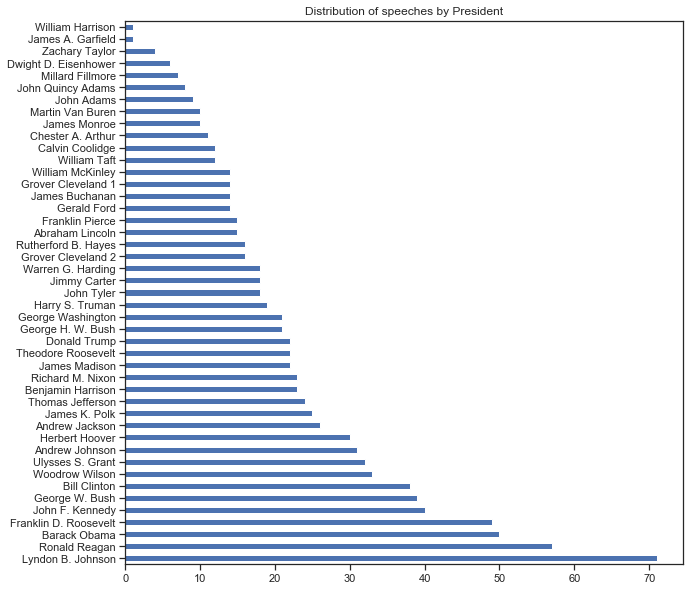

In [239]:
speeches.President.value_counts().plot.barh(figsize=(10,10),title='Distribution of speeches by President');

We can see hear that LBJ, Ronald Reagan, and Barack Obama ave the greatest number of speeches in the dataset. The William Harrison, James A. Garfield, and Zachary Taylor have the least amount of speeches. 

In [14]:
meta = ['President', 'Party', 'from', 'until', 'Vice President', 'title', 'date', 'info', 'pres_id', 'speech_id']
LIB = speeches[meta] # create the LIB dataframe

In [15]:
doc_fields = ['pres_id', 'speech_id', 'speech']
DOC = speeches[doc_fields].set_index(['pres_id', 'speech_id'])

In [16]:
DOC.head()

speech
pres_id speech_id                                                   
45      1          As long as I am President of the United States...
        2          Hello, everybody. Well, thank you very much. A...
        3          Last night, the United States brought the worl...
        4           Thank you very much.  Thank you. Well, thank ...
        5           Thank you very much.  Mr.  President, Mr.  Se...

In [17]:
#speeches.to_csv('speeches_checkpoint.csv',encoding='cp1252') #saving the checkpoint, can comment 

## Tokenize the documents

In [18]:
nltk.download('punkt')
nltk.download('averaged_perceptron_tagger')
nltk.download('stopwords')
nltk.download('tagsets')

[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\gwhy5\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     C:\Users\gwhy5\AppData\Roaming\nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\gwhy5\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package tagsets to
[nltk_data]     C:\Users\gwhy5\AppData\Roaming\nltk_data...
[nltk_data]   Package tagsets is already up-to-date!


True

In [19]:
def tokenize(doc_df, OHCO=OHCO, remove_pos_tuple=False, ws=False):
    
    # Speech to Sentences
    df = doc_df.speech\
        .apply(lambda x: pd.Series(nltk.sent_tokenize(x)))\
        .stack()\
        .to_frame()\
        .rename(columns={0:'sent_str'})
    
    # Sentences to Tokens
    # Local function to pick tokenizer
    def word_tokenize(x):
        if ws:
            s = pd.Series(nltk.pos_tag(nltk.WhitespaceTokenizer().tokenize(x)))
        else:
            s = pd.Series(nltk.pos_tag(nltk.word_tokenize(x)))
        return s
            
    df = df.sent_str\
        .apply(word_tokenize)\
        .stack()\
        .to_frame()\
        .rename(columns={0:'pos_tuple'})
    
    # Grab info from tuple
    df['pos'] = df.pos_tuple.apply(lambda x: x[1])
    df['token_str'] = df.pos_tuple.apply(lambda x: x[0])
    if remove_pos_tuple:
        df = df.drop('pos_tuple', 1)
    
    # Add index
    df.index.names = OHCO
    
    return df

In [20]:
TOKEN = tokenize(DOC, ws=True)

In [21]:
TOKEN

pos_tuple  pos   token_str
pres_id speech_id sent_num token_num                                    
45      1         0        0                   (As, RB)   RB          As
                           1                 (long, RB)   RB        long
                           2                   (as, IN)   IN          as
                           3                   (I, PRP)  PRP           I
                           4                  (am, VBP)  VBP          am
...                                                 ...  ...         ...
1       981       24       107                 (of, IN)   IN          of
                           108               (this, DT)   DT        this
                           109        (Government, NNP)  NNP  Government
                           110               (must, MD)   MD        must
                           111            (depend., VB)   VB     depend.

[2782716 rows x 3 columns]

## Reduce to VOCAB

In [22]:
TOKEN['term_str'] = TOKEN['token_str'].str.lower().str.replace('[\W_]', '')

In [23]:
VOCAB = TOKEN.term_str.value_counts().to_frame().rename(columns={'index':'term_str', 'term_str':'n'})\
    .sort_index().reset_index().rename(columns={'index':'term_str'})
VOCAB.index.name = 'term_id'

In [24]:
VOCAB['num'] = VOCAB.term_str.str.match("\d+").astype('int')

In [25]:
VOCAB.sample(10)

,term_str,n,num
term_id,,,
5332,artifices,2,0
38479,whined,1,0
20602,joint,309,0
20773,kane,1,0
4043,againwhen,1,0
2307,47511448,1,1
36096,trod,2,0
8464,childrens,68,0
22477,maneuverability,1,0


## Simple Unigram Model

In [26]:
n_tokens = VOCAB.n.sum()
VOCAB['p'] = VOCAB['n'] / n_tokens
VOCAB['log_p'] = np.log2(VOCAB['p'])

In [27]:
VOCAB.sort_values('p', ascending=False).head(10)

,term_str,n,num,p,log_p
term_id,,,,,
34954,the,207330,0,0.074506,-3.746493
24996,of,132571,0,0.047641,-4.391657
4634,and,97171,0,0.034919,-4.839824
35524,to,95697,0,0.034390,-4.861876
19017,in,58393,0,0.020984,-5.574554
3305,a,46211,0,0.016606,-5.912114
34921,that,42015,0,0.015099,-6.049445
20300,is,28330,0,0.010181,-6.618019
38177,we,27510,0,0.009886,-6.660394


In [28]:
smooth = VOCAB['p'].min()
def predict_sentence(sent_str):
    
    # Parse sentence into tokens and normalize string
    tokens = pd.DataFrame(sent_str.lower().split(), columns=['term_str'])
    
    # Link the tokens with model vocabulary
    tokens = tokens.merge(VOCAB, on='term_str', how='left') # Left join is key
    
    # Add minimum values where token is not in our vocabulary
    tokens.loc[tokens['p'].isna(), 'p'] = [smooth]
    
    # Compute probability of sentence by getting product of token probabilities
    p = tokens['p'].product()
        
    # Print results
    print("p('{}') = {}".format(sent_str, p))

In [29]:
predict_sentence('I love you')
predict_sentence('The economy is great')
predict_sentence("Turkey and Egypt")
predict_sentence("Four Score and Seven years")
predict_sentence("We are keeping in contact")
predict_sentence('Fake news')

p('I love you') = 3.998120445738189e-09
p('The economy is great') = 5.408821952154236e-10
p('Turkey and Egypt') = 3.337042490045785e-11
p('Four Score and Seven years') = 9.261874368504868e-18
p('We are keeping in contact') = 1.187574967871946e-15
p('Fake news') = 4.3662379544361287e-10


## Annotate (VOCAB)

### Add Stopwords

In [30]:
sw = pd.DataFrame(nltk.corpus.stopwords.words('english'), columns=['term_str'])
sw = sw.reset_index().set_index('term_str')
sw.columns = ['dummy']
sw.dummy = 1

In [31]:
VOCAB['stop'] = VOCAB.term_str.map(sw.dummy)
VOCAB['stop'] = VOCAB['stop'].fillna(0).astype('int')

In [32]:
VOCAB[VOCAB.stop == 1].sample(10)

,term_str,n,num,p,log_p,stop
term_id,,,,,,
38515,who,7130,0,0.002562,-8.608376,1
34904,than,4998,0,0.001796,-9.120927,1
25812,own,3393,0,0.001219,-9.679717,1
12739,doing,622,0,0.000224,-12.127291,1
24750,now,5621,0,0.002020,-8.951451,1
38435,when,4303,0,0.001546,-9.336935,1
32607,so,6808,0,0.002447,-8.675047,1
7620,by,19734,0,0.007092,-7.139666,1
39128,yourselves,70,0,0.000025,-15.278779,1


### Add Stems

In [33]:
from nltk.stem.porter import PorterStemmer

stemmer = PorterStemmer()
VOCAB['p_stem'] = VOCAB.term_str.apply(stemmer.stem)

In [34]:
VOCAB.sample(10)

,term_str,n,num,p,log_p,stop,p_stem
term_id,,,,,,,
26120,partnerships,38,0,1.365572e-05,-16.160135,0,partnership
33417,steal,14,0,5.031056e-06,-17.600707,0,steal
23494,mistakeall,1,0,3.593611e-07,-21.408062,0,mistakeal
19263,indices,1,0,3.593611e-07,-21.408062,0,indic
20094,introductions,1,0,3.593611e-07,-21.408062,0,introduct
20796,kates,1,0,3.593611e-07,-21.408062,0,kate
554,1538614,1,1,3.593611e-07,-21.408062,0,1538614
24316,neocolonialism,1,0,3.593611e-07,-21.408062,0,neocoloni
33100,sportsmanship,1,0,3.593611e-07,-21.408062,0,sportsmanship


## Save

In [35]:
#DOC.to_csv('DOC.csv',encoding = 'cp1252')
#LIB.to_csv('LIB.csv',encoding = 'cp1252')
#VOCAB.to_csv('VOCAB.csv',encoding = 'cp1252')
#TOKEN.to_csv('TOKEN.csv',encoding = 'cp1252')

## TDIF and Vector Space Models

In [36]:
count_method = 'n' # 'c' or 'n' # n = n tokens, c = distinct token (term) count
tf_method = 'sum' # sum, max, log, double_norm, raw, binary
tf_norm_k = .5 # only used for double_norm
idf_method = 'standard' # standard, max, smooth
gradient_cmap = 'GnBu' 

In [37]:
sns.set()
%matplotlib inline

In [38]:
TOKEN['term_id'] = TOKEN.term_str.map(VOCAB.reset_index().set_index('term_str').term_id)

In [39]:
TOKEN.head()

pos_tuple  pos token_str term_str  \
pres_id speech_id sent_num token_num                                       
45      1         0        0            (As, RB)   RB        As       as   
                           1          (long, RB)   RB      long     long   
                           2            (as, IN)   IN        as       as   
                           3            (I, PRP)  PRP         I        i   
                           4           (am, VBP)  VBP        am       am   

                                      term_id  
pres_id speech_id sent_num token_num           
45      1         0        0             5345  
                           1            21968  
                           2             5345  
                           3            18576  
                           4             4465

## Add Max Pos to VOCAB

In [40]:
VOCAB['pos_max'] = TOKEN.groupby(['term_id', 'pos']).count().iloc[:,0].unstack().idxmax(1)

In [41]:
VOCAB.sample(10)

,term_str,n,num,p,log_p,stop,p_stem,pos_max
term_id,,,,,,,,
20699,junglecovered,1,0,3.593611e-07,-21.408062,0,junglecov,JJ
9458,concede,33,0,1.185892e-05,-16.363668,0,conced,VB
23979,mustering,2,0,7.187223e-07,-20.408062,0,muster,VBG
613,16159616068,2,1,7.187223e-07,-20.408062,0,16159616068,VBN
38353,welltried,2,0,7.187223e-07,-20.408062,0,welltri,JJ
17184,grounding,1,0,3.593611e-07,-21.408062,0,ground,VBG
32228,silly,4,0,1.437445e-06,-19.408062,0,silli,RB
13683,encirclement,2,0,7.187223e-07,-20.408062,0,encircl,NN
2682,627923201,1,1,3.593611e-07,-21.408062,0,627923201,NNP


## A look at TOKEN POS graph

In [42]:
POS = TOKEN.pos.value_counts().to_frame().rename(columns={'pos':'n'})
POS.index.name = 'pos_id'

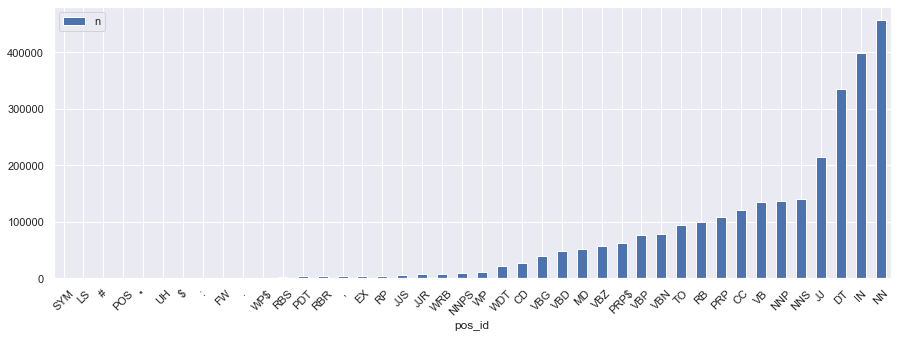

In [43]:
POS.sort_values('n').plot.bar(y='n', figsize=(15,5), rot=45);

The most common POS is the noun (which makes sense since they would be common in speeches pertaining to real world events) followed by preposition, and then determiners.

## Adding Term rank to VOCAB

In [44]:
if 'term_rank' not in VOCAB.columns:
    VOCAB = VOCAB.sort_values('n', ascending=False).reset_index()
    VOCAB.index.name = 'term_rank'
    VOCAB = VOCAB.reset_index()
    VOCAB = VOCAB.set_index('term_id')
    VOCAB['term_rank'] = VOCAB['term_rank'] + 1

In [45]:
VOCAB.head()

,term_rank,term_str,n,num,p,log_p,stop,p_stem,pos_max
term_id,,,,,,,,,
34954,1,the,207330,0,0.074506,-3.746493,1,the,DT
24996,2,of,132571,0,0.047641,-4.391657,1,of,IN
4634,3,and,97171,0,0.034919,-4.839824,1,and,CC
35524,4,to,95697,0,0.034390,-4.861876,1,to,TO
19017,5,in,58393,0,0.020984,-5.574554,1,in,IN


## Compute Zipf's K

In [46]:
VOCAB['zipf_k'] = VOCAB.n * VOCAB.term_rank

In [47]:
px.histogram(VOCAB, 'zipf_k', marginal='box')

This looks about right, however there is a fat tail at the end in which the count jumps up at around 300k

## Demo Rank Index

In [48]:
rank_index = [1, 2, 3, 15, 30, 45, 60, 75, 90, 105, 120, 235, 350, 400, 550, 675, 775, 875, 975, 1075, 2075, 3075, 4075, 5075, 6075, 7075, 8075]

In [49]:
demo = VOCAB.loc[VOCAB.term_rank.isin(rank_index), ['term_str', 'term_rank', 'n', 'zipf_k', 'pos_max']]

In [50]:
demo.style.background_gradient(cmap=gradient_cmap, high=.5)

,term_str,term_rank,n,zipf_k,pos_max
term_id,,,,,
34954,the,1,207330,207330,DT
24996,of,2,132571,265142,IN
4634,and,3,97171,291513,CC
17673,have,15,21183,317745,VBP
7589,but,30,11047,331410,CC
32607,so,45,6808,306360,RB
9678,congress,60,5447,326820,NNP
18089,his,75,4593,344475,PRP$
33309,state,90,3487,313830,NNP


## Compute VOCAB ENTROPY

In [51]:
%%time
VOCAB['p'] = VOCAB.n / VOCAB.n.sum()

Wall time: 998 µs


In [52]:
VOCAB['h'] = VOCAB.p * np.log2(1/VOCAB.p) # Self entropy of each word 
H = VOCAB.h.sum()
N_v = VOCAB.shape[0]
H_max = np.log2(N_v)
R = round(1 - (H/H_max), 2) * 100

## BOW

In [53]:
SENTS = OHCO[:3]
SPEECH = OHCO[:2]
PRES = OHCO[:1]

In [54]:
bag = SPEECH # choose speech as bag

In [55]:
BOW = TOKEN.groupby(bag+['term_id']).term_id.count()\
    .to_frame().rename(columns={'term_id':'n'})

In [56]:
BOW['c'] = BOW.n.astype('bool').astype('int')

In [57]:
BOW.head()

n  c
pres_id speech_id term_id       
1       961       0         1  1
                  740       1  1
                  761       1  1
                  1600      1  1
                  3305     57  1

# Document-Term Matrix

We create a document-term count matrix. 

In [58]:
DTCM = BOW[count_method].unstack().fillna(0).astype('int')

In [59]:
DTCM.head(10)

term_id            0      1      2      3      4      5      6      7      \
pres_id speech_id                                                           
1       961            1      0      0      0      0      0      0      0   
        962            2      0      0      0      0      0      0      0   
        963            0      0      0      0      0      0      0      0   
        964            0      0      0      0      0      0      0      0   
        965            1      0      0      0      0      0      0      0   
        966            0      0      0      0      0      0      0      0   
        967            2      0      0      0      0      0      0      0   
        968            0      0      0      0      0      0      0      0   
        969            2      0      0      0      0      0      0      0   
        970            1      0      0      0      0      0      0      0   

term_id            8      9      ...  39198  39199  39200  39201  39202  \
pres_id speech_id                ...                                      
1       961            0      0  ...      0      0      0      0      0   
        962            0      0  ...      0      0      0      0      0   
        963            0      0  ...      0      0      0      0      0   
        964            0      0  ...      0      0      0      0      0   
        965            0      0  ...      0      0      0      0      0   
        966            0      0  ...      0      0      0      0      0   
        967            0      0  ...      0      0      0      0      0   
        968            0      0  ...      0      0      0      0      0   
        969            0      0  ...      0      0      0      0      0   
        970            0      0  ...      0      0      0      0      0   

term_id            39203  39204  39205  39206  39207  
pres_id speech_id                                     
1       961            0      0      0      0      0  
        962            0      0      0      0      0  
        963            0      0      0      0      0  
        964            0      0      0      0      0  
        965            0      0      0      0      0  
        966            0      0      0      0      0  
        967            0      0      0      0      0  
        968            0      0      0      0      0  
        969            0      0      0      0      0  
        970            0      0      0      0      0  

[10 rows x 39208 columns]

### Compute TF

In [60]:
%%time
print('TF method:', tf_method)
if tf_method == 'sum':
    TF = DTCM.T / DTCM.T.sum()
elif tf_method == 'max':
    TF = DTCM.T / DTCM.T.max()
elif tf_method == 'log':
    TF = np.log10(1 + DTCM.T)
elif tf_method == 'raw':
    TF = DTCM.T
elif tf_method == 'double_norm':
    TF = DTCM.T / DTCM.T.max()
    TF = tf_norm_k + (1 - tf_norm_k) * TF[TF > 0]
elif tf_method == 'binary':
    TF = DTCM.T.astype('bool').astype('int')
TF = TF.T

TF method: sum
Wall time: 1.65 s


In [61]:
TF.head()

term_id               0      1      2      3      4      5      6      7      \
pres_id speech_id                                                              
1       961        0.000349    0.0    0.0    0.0    0.0    0.0    0.0    0.0   
        962        0.000375    0.0    0.0    0.0    0.0    0.0    0.0    0.0   
        963        0.000000    0.0    0.0    0.0    0.0    0.0    0.0    0.0   
        964        0.000000    0.0    0.0    0.0    0.0    0.0    0.0    0.0   
        965        0.000515    0.0    0.0    0.0    0.0    0.0    0.0    0.0   

term_id            8      9      ...  39198  39199  39200  39201  39202  \
pres_id speech_id                ...                                      
1       961          0.0    0.0  ...    0.0    0.0    0.0    0.0    0.0   
        962          0.0    0.0  ...    0.0    0.0    0.0    0.0    0.0   
        963          0.0    0.0  ...    0.0    0.0    0.0    0.0    0.0   
        964          0.0    0.0  ...    0.0    0.0    0.0    0.0    0.0   
        965          0.0    0.0  ...    0.0    0.0    0.0    0.0    0.0   

term_id            39203  39204  39205  39206  39207  
pres_id speech_id                                     
1       961          0.0    0.0    0.0    0.0    0.0  
        962          0.0    0.0    0.0    0.0    0.0  
        963          0.0    0.0    0.0    0.0    0.0  
        964          0.0    0.0    0.0    0.0    0.0  
        965          0.0    0.0    0.0    0.0    0.0  

[5 rows x 39208 columns]

### Compute DF

In [62]:
%%time
DF = DTCM[DTCM > 0].count()

Wall time: 16.2 s


### Compute IDF

In [63]:
N = DTCM.shape[0]

In [64]:
%%time
print('IDF method:', idf_method)
if idf_method == 'standard':
    IDF = np.log10(N / DF)
elif idf_method == 'max':
    IDF = np.log10(DF.max() / DF) 
elif idf_method == 'smooth':
    IDF = np.log10((1 + N) / (1 + DF)) + 1

IDF method: standard
Wall time: 6 ms


### Compute TFIDF

In [65]:
TFIDF = TF * IDF

In [66]:
TFIDF.head()

term_id               0      1      2      3      4      5      6      7      \
pres_id speech_id                                                              
1       961        0.000068    0.0    0.0    0.0    0.0    0.0    0.0    0.0   
        962        0.000073    0.0    0.0    0.0    0.0    0.0    0.0    0.0   
        963        0.000000    0.0    0.0    0.0    0.0    0.0    0.0    0.0   
        964        0.000000    0.0    0.0    0.0    0.0    0.0    0.0    0.0   
        965        0.000100    0.0    0.0    0.0    0.0    0.0    0.0    0.0   

term_id            8      9      ...  39198  39199  39200  39201  39202  \
pres_id speech_id                ...                                      
1       961          0.0    0.0  ...    0.0    0.0    0.0    0.0    0.0   
        962          0.0    0.0  ...    0.0    0.0    0.0    0.0    0.0   
        963          0.0    0.0  ...    0.0    0.0    0.0    0.0    0.0   
        964          0.0    0.0  ...    0.0    0.0    0.0    0.0    0.0   
        965          0.0    0.0  ...    0.0    0.0    0.0    0.0    0.0   

term_id            39203  39204  39205  39206  39207  
pres_id speech_id                                     
1       961          0.0    0.0    0.0    0.0    0.0  
        962          0.0    0.0    0.0    0.0    0.0  
        963          0.0    0.0    0.0    0.0    0.0  
        964          0.0    0.0    0.0    0.0    0.0  
        965          0.0    0.0    0.0    0.0    0.0  

[5 rows x 39208 columns]

Move it into VOCAB

In [67]:
VOCAB['df'] = DF
VOCAB['idf'] = IDF

In [68]:
VOCAB.head()

,term_rank,term_str,n,num,p,log_p,stop,p_stem,pos_max,zipf_k,h,df,idf
term_id,,,,,,,,,,,,,
34954,1,the,207330,0,0.074506,-3.746493,1,the,DT,207330,0.279137,981,0.000000
24996,2,of,132571,0,0.047641,-4.391657,1,of,IN,265142,0.209222,981,0.000000
4634,3,and,97171,0,0.034919,-4.839824,1,and,CC,291513,0.169004,981,0.000000
35524,4,to,95697,0,0.034390,-4.861876,1,to,TO,382788,0.167199,981,0.000000
19017,5,in,58393,0,0.020984,-5.574554,1,in,IN,291965,0.116977,979,0.000886


In [69]:
BOW['tf'] = TF.stack()
BOW['tfidf'] = TFIDF.stack()

In [70]:
BOW.head()

n  c        tf     tfidf
pres_id speech_id term_id                           
1       961       0         1  1  0.000349  0.000068
                  740       1  1  0.000349  0.000711
                  761       1  1  0.000349  0.000878
                  1600      1  1  0.000349  0.000529
                  3305     57  1  0.019902  0.000026

### Apply aggregates to VOCAB and visualize

In [71]:
%%time
VOCAB['tfidf_mean'] = TFIDF[TFIDF > 0].mean().fillna(0) # EXPLAIN
VOCAB['tfidf_sum'] = TFIDF.sum()
VOCAB['tfidf_median'] = TFIDF[TFIDF > 0].median().fillna(0) # EXPLAIN
VOCAB['tfidf_max'] = TFIDF.max()

Wall time: 29.8 s


### Make a VOCAB without stopwords

In [72]:
VOCAB_nostop = VOCAB[VOCAB['stop'] == 0] # VOCAB table with no stop words
VOCAB_nostop.head(10)

,term_rank,term_str,n,num,p,log_p,stop,p_stem,pos_max,zipf_k,h,df,idf,tfidf_mean,tfidf_sum,tfidf_median,tfidf_max
term_id,,,,,,,,,,,,,,,,,
33331,33,states,9889,0,0.003554,-8.136453,0,state,NNPS,326337,0.028915,883,0.045708,0.000225,0.198709,0.000128,0.001600
16903,37,government,8864,0,0.003185,-8.294320,0,govern,NNP,327968,0.026421,843,0.065841,0.000238,0.200358,0.000184,0.001728
26429,39,people,8757,0,0.003147,-8.311841,0,peopl,NNS,341523,0.026157,845,0.064812,0.000235,0.198839,0.000204,0.001013
36935,41,united,8259,0,0.002968,-8.396311,0,unit,NNP,338619,0.024920,866,0.054151,0.000240,0.207941,0.000141,0.002006
0,46,,6714,0,0.002413,-8.695105,0,,",",308844,0.020979,627,0.194401,0.000613,0.384525,0.000233,0.019881
38894,49,would,6380,0,0.002293,-8.768722,0,would,MD,312620,0.020104,821,0.077326,0.000196,0.160981,0.000155,0.001767
37362,55,us,5682,0,0.002042,-8.935879,0,us,PRP,312510,0.018246,764,0.108576,0.000296,0.226207,0.000224,0.002432
9678,60,congress,5447,0,0.001957,-8.996816,0,congress,NNP,326820,0.017611,719,0.134940,0.000351,0.252120,0.000262,0.002776
25184,61,one,5394,0,0.001938,-9.010922,0,one,CD,329034,0.017467,843,0.065841,0.000145,0.122097,0.000124,0.001266


In [73]:
VOCAB.sort_values('tfidf_sum', ascending=False).head(50).style.background_gradient(cmap=gradient_cmap)

,term_rank,term_str,n,num,p,log_p,stop,p_stem,pos_max,zipf_k,h,df,idf,tfidf_mean,tfidf_sum,tfidf_median,tfidf_max
term_id,,,,,,,,,,,,,,,,,
38177,9,we,27510,0,0.00988603,-6.66039,1,we,PRP,247590,0.0658448,838,0.068425,0.000745261,0.624529,0.000677599,0.00319973
39105,36,you,9073,0,0.00326048,-8.2607,1,you,PRP,326628,0.0269339,688,0.154081,0.000766972,0.527677,0.000429197,0.00708115
25482,10,our,27422,0,0.0098544,-6.66502,1,our,PRP$,274220,0.0656797,888,0.043256,0.000446768,0.39673,0.000411962,0.00155804
0,46,,6714,0,0.00241275,-8.69511,0,,",",308844,0.0209791,627,0.194401,0.000613278,0.384525,0.000232816,0.0198809
31841,95,shall,3302,0,0.00118661,-9.71894,0,shall,MD,313690,0.0115326,589,0.221554,0.000555469,0.327172,0.000351983,0.00507375
37713,315,vietnam,926,0,0.000332768,-11.5532,0,vietnam,NNP,291690,0.00384454,107,0.962285,0.00302551,0.32373,0.00101793,0.0320762
35988,171,treaty,1710,0,0.000614508,-10.6683,0,treati,NN,292410,0.00655574,284,0.538351,0.0011357,0.322539,0.000528873,0.010362
38442,1553,whereas,192,0,6.89973e-05,-13.8231,0,wherea,NNP,298176,0.000953757,71,1.14041,0.00437946,0.310942,0.00393245,0.0150754
6640,205,bill,1410,0,0.000506699,-10.9466,0,bill,NN,289050,0.00554662,288,0.532277,0.00106776,0.307515,0.000397872,0.0183953


In [74]:
VOCAB_nostop.sort_values('tfidf_sum', ascending=False).head(50).style.background_gradient(cmap=gradient_cmap)

,term_rank,term_str,n,num,p,log_p,stop,p_stem,pos_max,zipf_k,h,df,idf,tfidf_mean,tfidf_sum,tfidf_median,tfidf_max
term_id,,,,,,,,,,,,,,,,,
0,46,,6714,0,0.00241275,-8.69511,0,,",",308844,0.0209791,627,0.194401,0.000613278,0.384525,0.000232816,0.0198809
31841,95,shall,3302,0,0.00118661,-9.71894,0,shall,MD,313690,0.0115326,589,0.221554,0.000555469,0.327172,0.000351983,0.00507375
37713,315,vietnam,926,0,0.000332768,-11.5532,0,vietnam,NNP,291690,0.00384454,107,0.962285,0.00302551,0.32373,0.00101793,0.0320762
35988,171,treaty,1710,0,0.000614508,-10.6683,0,treati,NN,292410,0.00655574,284,0.538351,0.0011357,0.322539,0.000528873,0.010362
38442,1553,whereas,192,0,6.89973e-05,-13.8231,0,wherea,NNP,298176,0.000953757,71,1.14041,0.00437946,0.310942,0.00393245,0.0150754
6640,205,bill,1410,0,0.000506699,-10.9466,0,bill,NN,289050,0.00554662,288,0.532277,0.00106776,0.307515,0.000397872,0.0183953
38839,65,world,5167,0,0.00185682,-9.07295,0,world,NN,335855,0.0168468,688,0.154081,0.000434464,0.298911,0.000298207,0.00443397
4522,88,america,3563,0,0.0012804,-9.60919,0,america,NNP,313544,0.0123036,597,0.215695,0.000496348,0.29632,0.000339944,0.00395367
9851,154,constitution,1842,0,0.000661943,-10.561,0,constitut,NNP,283668,0.00699079,387,0.403958,0.000747293,0.289202,0.000309546,0.00594056


In [75]:
VOCAB[['term_rank','term_str','pos_max','tfidf_sum']].sort_values('tfidf_sum', ascending=False).head(50).style.background_gradient(cmap=gradient_cmap)

,term_rank,term_str,pos_max,tfidf_sum
term_id,,,,
38177,9,we,PRP,0.624529
39105,36,you,PRP,0.527677
25482,10,our,PRP$,0.39673
0,46,,",",0.384525
31841,95,shall,MD,0.327172
37713,315,vietnam,NNP,0.32373
35988,171,treaty,NN,0.322539
38442,1553,whereas,NNP,0.310942
6640,205,bill,NN,0.307515


In [76]:
VOCAB_nostop[['term_rank','term_str','pos_max','tfidf_sum']].sort_values('tfidf_sum', ascending=False).head(50).style.background_gradient(cmap=gradient_cmap)

,term_rank,term_str,pos_max,tfidf_sum
term_id,,,,
0,46,,",",0.384525
31841,95,shall,MD,0.327172
37713,315,vietnam,NNP,0.32373
35988,171,treaty,NN,0.322539
38442,1553,whereas,NNP,0.310942
6640,205,bill,NN,0.307515
38839,65,world,NN,0.298911
4522,88,america,NNP,0.29632
9851,154,constitution,NNP,0.289202


I am suprised by how many terms do not make an impact on the tfidf_sum. "we' and 'you' have the greatest impact here, both words high term ranks

In [77]:
BOW = BOW.join(VOCAB[['term_str','pos_max']], on='term_id')

In [78]:
BOW.sort_values('tfidf', ascending=False).head(20).style.background_gradient(cmap=gradient_cmap, high=.5)

,,,n,c,tf,tfidf,term_str,pos_max
pres_id,speech_id,term_id,,,,,,
17,747,16146,5,1,0.0183824,0.038393,freedmen,NNS
21,668,11207,20,1,0.0165017,0.035422,deck,NN
22,656,33386,10,1,0.0185185,0.0347727,statue,NN
18,695,30857,8,1,0.0196078,0.0335866,salary,NN
36,321,12772,5,1,0.0203252,0.0335213,dominican,NNP
22,655,25039,5,1,0.0138889,0.033189,officeholders,NNS
36,285,37713,14,1,0.0333333,0.0320762,vietnam,NNP
45,2,32676,6,1,0.0115163,0.0309862,soleimani,NNP
41,166,25947,20,1,0.0259067,0.0301967,panama,NNP


The highest tfidf terms are freedman, deck, and statue

### Rank and TFIDF mean

In [79]:
px.scatter(VOCAB, x='term_rank', y='tfidf_mean', hover_name='term_str', hover_data=['n'], color='pos_max', 
           log_x=False, log_y=False)

The highest POS on the tfidf_mean scale are the NNP (Proper Nouns). This makes sense since certain speeches will revolve around certain historical characters/places/things.

### Rank and TFIDF sum

In [80]:
px.scatter(VOCAB, x='term_rank', y='tfidf_sum', hover_name='term_str', hover_data=['n'], color='pos_max')

The NN (Noun singular or mass) seems to be consistantly on top of the slope, with NNP's around there as well. The tfidf_sum looks like it accounts for the difference in singular (or mass) and proper nouns

### Show Demo Table with TFIDF

In [81]:
demo2 = VOCAB_nostop.loc[VOCAB.term_rank.isin(rank_index), ['term_str', 'pos_max', 'term_rank', 'n', 'zipf_k', 'tfidf_mean', 'tfidf_sum', 'tfidf_max']]

In [82]:
demo2.style.background_gradient(cmap=gradient_cmap)

,term_str,pos_max,term_rank,n,zipf_k,tfidf_mean,tfidf_sum,tfidf_max
term_id,,,,,,,,
9678,congress,NNP,60,5447,326820,0.000350653,0.25212,0.00277614
33309,state,NNP,90,3487,313830,0.000321768,0.220411,0.0037544
24097,national,JJ,120,2554,306480,0.000257064,0.163492,0.00155547
27369,powers,NNS,235,1227,288345,0.000415166,0.163576,0.00668646
9781,consideration,NN,350,856,299600,0.000412571,0.139037,0.00423136
4573,amount,NN,400,741,296400,0.000431974,0.116633,0.00337127
32337,situation,NN,550,543,298650,0.000477186,0.128363,0.00685264
28837,really,RB,675,440,297000,0.000408449,0.0869996,0.00369962
38955,wrong,JJ,775,395,306125,0.000385781,0.0825572,0.00305853


It is interesting that the country of panama shows up prominently in the above table. It is clearly important in US world affairs judging by it's tfidf scores

In [83]:
px.scatter(demo2, x='term_rank', y='tfidf_sum', log_x=True, log_y=True, text='term_str', color='pos_max', size='n')

When using the VOCAB with no stopwords, the tfidf_sum decreases as term rank increases, which makes sense. This is not the case with tfidf_mean measure, which is high for some terms that are have a high rank

### Save new files

In [84]:
#VOCAB.to_csv('VOCAB2.csv',encoding = 'cp1252')
#TOKEN.to_csv('TOKEN2.csv',encoding = 'cp1252')
#BOW.to_csv('DOC2.csv',encoding = 'cp1252')
#DTCM.to_csv('DTCM.csv',encoding = 'cp1252')
#TFIDF.to_csv('TFIDF.csv',encoding = 'cp1252')

# Similarity and Distance Measures
Here we will group by speeches to better analyze/visualize the data

In [85]:
sns.set(style="ticks")
%matplotlib inline

In [86]:
OHCO_src = ['pres_id', 'speech_id']
TFIDF1 = TFIDF.reset_index().set_index(OHCO_src)
LIB1 = LIB.reset_index().set_index('pres_id')

In [87]:
TFIDF1.head()

term_id               0      1      2      3      4      5      6      7      \
pres_id speech_id                                                              
1       961        0.000068    0.0    0.0    0.0    0.0    0.0    0.0    0.0   
        962        0.000073    0.0    0.0    0.0    0.0    0.0    0.0    0.0   
        963        0.000000    0.0    0.0    0.0    0.0    0.0    0.0    0.0   
        964        0.000000    0.0    0.0    0.0    0.0    0.0    0.0    0.0   
        965        0.000100    0.0    0.0    0.0    0.0    0.0    0.0    0.0   

term_id            8      9      ...  39198  39199  39200  39201  39202  \
pres_id speech_id                ...                                      
1       961          0.0    0.0  ...    0.0    0.0    0.0    0.0    0.0   
        962          0.0    0.0  ...    0.0    0.0    0.0    0.0    0.0   
        963          0.0    0.0  ...    0.0    0.0    0.0    0.0    0.0   
        964          0.0    0.0  ...    0.0    0.0    0.0    0.0    0.0   
        965          0.0    0.0  ...    0.0    0.0    0.0    0.0    0.0   

term_id            39203  39204  39205  39206  39207  
pres_id speech_id                                     
1       961          0.0    0.0    0.0    0.0    0.0  
        962          0.0    0.0    0.0    0.0    0.0  
        963          0.0    0.0    0.0    0.0    0.0  
        964          0.0    0.0    0.0    0.0    0.0  
        965          0.0    0.0    0.0    0.0    0.0  

[5 rows x 39208 columns]

## Create a DOC table

We want to create a new table that maps the OHCO levels to a single doc_id. We do this so that when we create a table to store pairs of docs and their distances, we can use a single-valued ID for each docs. 

This table will also be used to store cluster assignments.

In [88]:
DOC1 = TFIDF1.reset_index().set_index('speech_id')[PRES] # We create a table from the OHCO in our TFIDF table

In [89]:
title_df = speeches[['speech_id','title']].copy().set_index('speech_id')
TFIDF1 = TFIDF1.merge(title_df,on='speech_id')

In [90]:
DOC1.head()

term_id,pres_id
speech_id,
961,1
962,1
963,1
964,1
965,1


## Add a meaningful Title to DOC index

In [91]:
presidents = pd.Series(LIB1.groupby('pres_id')['President'].unique(),dtype=str) # capture presidents names by pres_id
DOC1['president'] = DOC1.pres_id.map(presidents) # add in presidents names
speech_titles = TFIDF1.groupby('speech_id')['title'].first().to_frame() # capture the speech titles by speech_id
DOC1 = DOC1.merge(speech_titles, on='speech_id') # add in the speech titles
DOC1['president_speech'] = DOC1['president'].str.cat(DOC1['title'],sep=" ") # concatinate president and title col
TFIDF1 = TFIDF.reset_index().set_index(OHCO_src) # return the TFIDF1 table back to original for processing
DOC1 = DOC1.reset_index().set_index('speech_id').drop(['president','title'],axis=1) # remove president, title col

In [92]:
DOC1.head()

,pres_id,president_speech
speech_id,,
961,1,"['George Washington'] December 7, 1796: Eighth..."
962,1,"['George Washington'] September 19, 1796: Fare..."
963,1,"['George Washington'] August 29, 1796: Talk to..."
964,1,"['George Washington'] March 30, 1796: Message ..."
965,1,"['George Washington'] December 8, 1795: Sevent..."


## Create Normalized Tables


In [93]:
L0 = TFIDF1.astype('bool').astype('int')
L1 = TFIDF1.apply(lambda x: x / x.sum(), 1)
L2 = TFIDF1.apply(lambda x: x / norm(x), 1)

## Create Doc Pair Table

Create a table to store our results.

In [94]:
PAIRS = pd.DataFrame(index=pd.MultiIndex.from_product([DOC1.index.tolist(), DOC1.index.tolist()])).reset_index()
PAIRS = PAIRS[PAIRS.level_0 < PAIRS.level_1].set_index(['level_0','level_1'])
PAIRS.index.names = ['doc_a', 'doc_b']

In [95]:
PAIRS.head()

Empty DataFrame
Columns: []
Index: [(961, 962), (961, 963), (961, 964), (961, 965), (961, 966)]

# Compute Distances

In [96]:
%time PAIRS['cityblock'] = pdist(TFIDF1, 'cityblock')

Wall time: 28 s


In [97]:
%time PAIRS['euclidean'] = pdist(TFIDF1, 'euclidean')

Wall time: 27.6 s


In [98]:
%time PAIRS['cosine'] = pdist(TFIDF1, 'cosine')

Wall time: 27.3 s


In [99]:
PAIRS.head()

cityblock  euclidean    cosine
doc_a doc_b                                
961   962     0.703276   0.019077  0.835668
      963     0.713195   0.031381  0.923525
      964     0.644747   0.027020  0.894869
      965     0.650132   0.021915  0.792182
      966     0.886596   0.062986  0.975514

# Create Clusters

## Hierarchical

In [100]:
def hca(name,sims, linkage_method='ward', color_thresh=.3, figsize=(15, 100)):
    tree = sch.linkage(sims, method=linkage_method)
    labels = DOC1.president_speech.values
    plt.figure()
    fig, axes = plt.subplots(figsize=figsize)
    dendrogram = sch.dendrogram(tree, 
                                labels=labels, 
                                orientation="left", 
                                count_sort=True,
                                distance_sort=True,
                                above_threshold_color='.75',
                                color_threshold=color_thresh
                               )
    plt.tick_params(axis='both', which='major', labelsize=8)
    plt.savefig(name)

<Figure size 432x288 with 0 Axes>

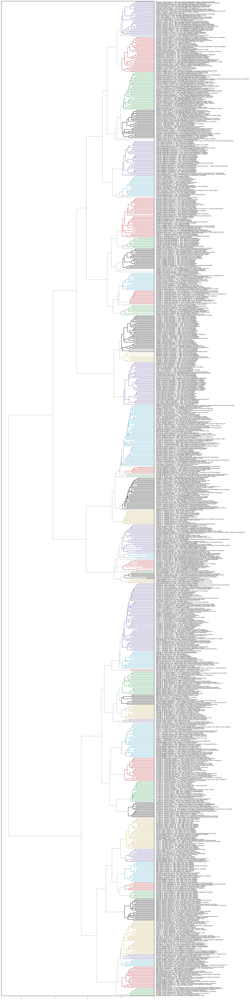

In [101]:
hca('cityblock_pairs.jpeg',PAIRS.cityblock, color_thresh=1) #adjust size as needed here

<Figure size 432x288 with 0 Axes>

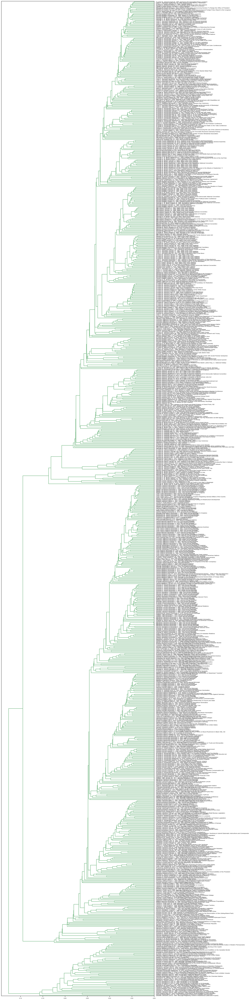

In [102]:
hca("euclidean_pairs.jpeg",PAIRS.euclidean, color_thresh=1)

<Figure size 432x288 with 0 Axes>

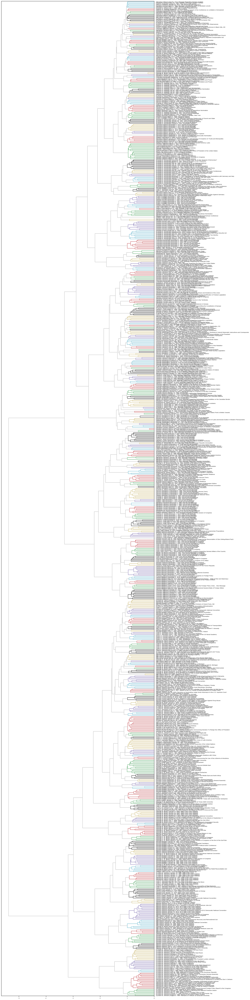

In [103]:
hca('cosine_pairs.jpeg',PAIRS.cosine, color_thresh=1)

There are very interesting things going on in those graphs, cityblock and cosine in particular. A lot of the times since presidents use similar styles and word choices, and are talking about similar things throughout their presidency, presidential speeches bunch up with the particular president. When different presidents get bunched up is when it gets interesting. For instance, the model can pick up the inagural addresses of different presidents, and things like foreign policy speeches (speeches by Carter, Bush Sr, Obama, etc bunch up in foreign policy speeches. One group in the cosine model looks like they are bunching up around Middle East topics in particular). I can also see certain speeches on drugs or crime bunch up together as well.

## K-Means

In [104]:
n_clusters = 17

In [105]:
DOC1['y_raw'] = KMeans(n_clusters).fit_predict(TFIDF)
DOC1['y_L0'] = KMeans(n_clusters).fit_predict(L0)
DOC1['y_L1'] = KMeans(n_clusters).fit_predict(L1)
DOC1['y_L2'] = KMeans(n_clusters).fit_predict(L2)

In [106]:
DOC1.sort_values('y_L0').style.background_gradient(cmap='viridis')

We see much of the same behavior in K-means clustering

## PCA

In [107]:
OHCO = ['pres_id', 'speech_id','sent_num', 'token_num']
SPEECH = OHCO[:2]
PRES = OHCO[:1]

In [108]:
TFIDF_s = TFIDF.reset_index().set_index(SPEECH) # group by speeches
TFIDF_p = TFIDF.reset_index().set_index(PRES) # group by presidents

In [109]:
TFIDF_p = TFIDF_p.groupby('pres_id').mean() # get the mean, by presidents

In [110]:
top_4000_terms = VOCAB_nostop.sort_values('tfidf_sum', ascending=False).iloc[:4000].index.tolist()

In [111]:
TFIDF_s = TFIDF_s[top_4000_terms] # select only the top 4000 terms
TFIDF_p = TFIDF_p[top_4000_terms]

In [112]:
#TFIDF_s = TFIDF_s - TFIDF_s.mean() # don't need to do this
#TFIDF_p = TFIDF_p - TFIDF_p.mean()

# Compute Covariance Matrix

In [113]:
COV_s = TFIDF_s.T.dot(TFIDF_s) 
COV_p = TFIDF_p.T.dot(TFIDF_p)  

In [114]:
COV_s.iloc[:5,:10].style.background_gradient()

term_id,0,31841,37713,35988,38442,6640,38839,4522,9851,37313
term_id,,,,,,,,,,
0,0.0013761,7.78147e-05,5.60321e-05,0.000112379,5.05371e-05,0.000183993,0.000116621,0.000140093,7.00396e-05,7.40673e-05
31841,7.78147e-05,0.00044273,8.55975e-05,0.000141792,0.000249499,0.000116831,6.16817e-05,7.38613e-05,0.00020866,0.000130677
37713,5.60321e-05,8.55975e-05,0.00316267,2.38209e-05,4.47932e-07,2.92328e-05,0.000128371,8.22261e-05,1.18213e-05,2.2944e-05
35988,0.000112379,0.000141792,2.38209e-05,0.00119262,0.000150391,2.95959e-05,7.85376e-05,7.33114e-05,6.73721e-05,0.000106995
38442,5.05371e-05,0.000249499,4.47932e-07,0.000150391,0.00229925,3.34861e-06,1.24343e-05,0.000181643,0.000175475,0.000108581


# Decompose the Matrix


In [115]:
%time eig_vals_s, eig_vecs_s = eig(COV_s)
%time eig_vals_p, eig_vecs_p = eig(COV_p)

Wall time: 8.87 s
Wall time: 8.72 s


## Convert eigen data to dataframes

In [116]:
TERM_IDX = COV_p.index # We could use other tables as well, e.g. TFIDF_b, TFIDF_c, or COV_c

In [117]:
EIG_VEC_s = pd.DataFrame(eig_vecs_s, index=TERM_IDX, columns=TERM_IDX)
EIG_VEC_p = pd.DataFrame(eig_vecs_p, index=TERM_IDX, columns=TERM_IDX)

In [118]:
EIG_VAL_s = pd.DataFrame(eig_vals_s, index=TERM_IDX, columns=['eig_val'])
EIG_VAL_s.index.name = 'term_id'

EIG_VAL_p = pd.DataFrame(eig_vals_p, index=TERM_IDX, columns=['eig_val'])
EIG_VAL_p.index.name = 'term_id'

In [119]:
EIG_VEC_p.iloc[:5, :10].style.background_gradient()

term_id,0,31841,37713,35988,38442,6640,38839,4522,9851,37313
term_id,,,,,,,,,,
0,-0.0506116,0.591393,0,0,0,0,0,0,0,0
31841,0.643418,0.107878,0.0553847,-0.0475322,0.320181,0.00701526,-0.00387478,-0.00656034,-0.0020367,0.00732283
37713,-0.0540552,0.127958,0.0488952,0.0996806,0.398242,-0.00257913,0.00265072,-0.0597353,-0.0251984,0.0245041
35988,0.343091,0.163591,-0.119853,0.277749,-0.522658,-0.0432942,-0.00982901,-0.00856271,-0.0271824,0.0234381
38442,0.0251542,0.0421391,-0.264129,-0.200459,0.212278,0.166364,-0.0666186,-0.0176804,-0.130844,0.106729


# Select Principal Components


## Combine eigenvalues and eignvectors


In [120]:
EIG_PAIRS_s = EIG_VAL_s.join(EIG_VEC_s.T)
EIG_PAIRS_p = EIG_VAL_p.join(EIG_VEC_p.T)

## Compute and Show Explained Variance


In [121]:
EIG_PAIRS_p['exp_var'] = np.round((EIG_PAIRS_p.eig_val / EIG_PAIRS_p.eig_val.sum()) * 100, 2)
EIG_PAIRS_s['exp_var'] = np.round((EIG_PAIRS_s.eig_val / EIG_PAIRS_s.eig_val.sum()) * 100, 2)

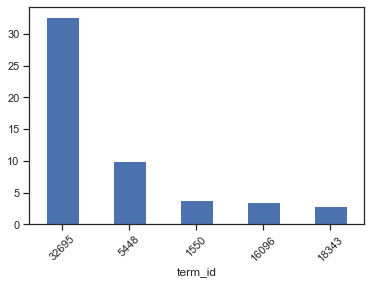

In [122]:
EIG_PAIRS_p.exp_var.sort_values(ascending=False).head().plot.bar(rot=45)

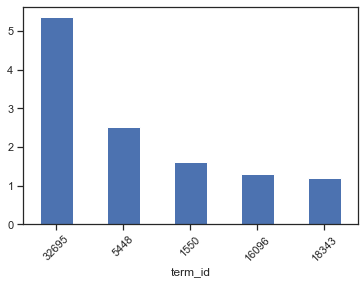

In [123]:
EIG_PAIRS_s.exp_var.sort_values(ascending=False).head().plot.bar(rot=45)

## Pick Top K (10) Components


In [124]:
TOPS_p = EIG_PAIRS_p.sort_values('exp_var', ascending=False).head(10).reset_index(drop=True)
TOPS_p.index.name = 'comp_id'
TOPS_p.index = ["PC{}".format(i) for i in TOPS_p.index.tolist()]

In [125]:
TOPS_s = EIG_PAIRS_s.sort_values('exp_var', ascending=False).head(10).reset_index(drop=True)
TOPS_s.index.name = 'comp_id'
TOPS_s.index = ["PC{}".format(i) for i in TOPS_s.index.tolist()]

## Show Loadings


In [126]:
LOADINGS_p = TOPS_p[TERM_IDX].T
LOADINGS_p.index.name = 'term_id'

In [127]:
LOADINGS_p.head().style.background_gradient()

,PC0,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9
term_id,,,,,,,,,,
0,-0.0622564,0.0588167,0.0325297,0.0228399,-0.004215,0.0317887,0.0608873,0.073252,0.135206,-0.0476163
31841,-0.0874949,-0.0511419,-0.00171027,-0.0416778,-0.00166721,0.0326038,0.000574663,-0.074383,0.00981016,0.0637122
37713,-0.0283258,0.0835817,0.0160327,-0.00741432,0.00651361,-0.00261538,-0.0176588,-0.0827972,-0.081418,0.0172069
35988,-0.0986516,-0.082107,0.0986847,-0.00276005,0.000499041,0.15361,-0.0432002,0.112669,-0.127629,0.0940137
38442,-0.0835769,-0.0942229,-0.00528171,0.0839426,-0.0921914,-0.164456,-0.0263564,-0.0681801,-0.020973,0.0202516


In [128]:
LOADINGS_s = TOPS_s[TERM_IDX].T
LOADINGS_s.index.name = 'term_id'

In [129]:
LOADINGS_s.head().style.background_gradient()

,PC0,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9
term_id,,,,,,,,,,
0,-0.0863284,0.0594187,-0.0274365,0.0183304,-0.0624149,-0.0245326,0.00016567,-0.00361747,-0.0191403,0.00428892
31841,-0.0732354,-0.0602406,0.0386778,-0.0164053,0.0197722,0.00159495,-0.0186808,0.0380036,-0.0017639,0.0290281
37713,-0.0791425,0.08895,-0.0781149,-0.0447783,0.582612,0.376939,-0.0527987,-0.250889,0.139293,0.0552695
35988,-0.0726235,-0.0420399,0.0995287,-0.0536886,0.0667975,-0.0535823,0.0947535,0.0876763,-0.0324074,-0.133996
38442,-0.0985236,-0.323969,-0.253142,0.038084,-0.0430462,0.0426813,0.0659779,-0.0704532,0.0102574,-0.0529471


In [130]:
LOADINGS_p['term_str'] = LOADINGS_p.apply(lambda x: VOCAB.loc[int(x.name)].term_str, 1)
LOADINGS_s['term_str'] = LOADINGS_s.apply(lambda x: VOCAB.loc[int(x.name)].term_str, 1)

In [131]:
lp0_pos = LOADINGS_p.sort_values('PC0', ascending=False).head(10).term_str.str.cat(sep=' ')
lp0_neg = LOADINGS_p.sort_values('PC0', ascending=True).head(10).term_str.str.cat(sep=' ')
lp1_pos = LOADINGS_p.sort_values('PC1', ascending=False).head(10).term_str.str.cat(sep=' ')
lp1_neg = LOADINGS_p.sort_values('PC1', ascending=True).head(10).term_str.str.cat(sep=' ')
lp2_pos = LOADINGS_p.sort_values('PC2', ascending=False).head(10).term_str.str.cat(sep=' ')
lp2_neg = LOADINGS_p.sort_values('PC2', ascending=True).head(10).term_str.str.cat(sep=' ')
ls0_pos = LOADINGS_s.sort_values('PC0', ascending=False).head(10).term_str.str.cat(sep=' ')
ls0_neg = LOADINGS_s.sort_values('PC0', ascending=True).head(10).term_str.str.cat(sep=' ')
ls1_pos = LOADINGS_s.sort_values('PC1', ascending=False).head(10).term_str.str.cat(sep=' ')
ls1_neg = LOADINGS_s.sort_values('PC1', ascending=True).head(10).term_str.str.cat(sep=' ')
ls2_pos = LOADINGS_s.sort_values('PC2', ascending=False).head(10).term_str.str.cat(sep=' ')
ls2_neg = LOADINGS_s.sort_values('PC2', ascending=True).head(10).term_str.str.cat(sep=' ')

# Project Docs onto New Subspace


In [132]:
DCM_s = TFIDF_s.dot(TOPS_s[TERM_IDX].T)
DCM_p = TFIDF_p.dot(TOPS_p[TERM_IDX].T)

In [133]:
DCM_s = DCM_s.merge(speeches[['pres_id','speech_id','President','title']], on=['pres_id','speech_id']).set_index(SPEECH)
DCM_p = DCM_p.merge(group_df.reset_index()[['President','pres_id']], on='pres_id').set_index(PRES)
DCM_p['title'] = DCM_p['President'] # need to set the title to president to visualize it

In [134]:
DCM_s.head().style.background_gradient()

In [135]:
DCM_p.head().style.background_gradient()

,PC0,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,President,title
pres_id,,,,,,,,,,,,
1,-0.00507095,-0.00200132,0.000935989,-0.0011669,0.00023345,-0.00356115,-0.000800896,0.000148559,0.000500408,0.00126319,George Washington,George Washington
2,-0.0049457,-0.00159029,0.00135361,-0.00180707,0.00167537,-0.00422503,-0.00234712,0.00180026,0.00101062,0.00247226,John Adams,John Adams
3,-0.00454918,-0.000905527,0.00080991,-0.000832464,0.000625382,-0.00131087,-0.000794893,0.000739107,0.000414424,-0.000396081,Thomas Jefferson,Thomas Jefferson
4,-0.00490788,-0.00161082,0.000813562,-0.000812982,0.000749271,-0.00166448,-0.00111489,0.000779528,5.02823e-05,-0.000860625,James Madison,James Madison
5,-0.00487679,-0.00177552,0.00125028,-0.000719933,0.00108378,-0.000291477,-0.00069165,0.0014081,0.000338055,-0.000995113,James Monroe,James Monroe


# Visualize

In [136]:
def vis_pcs(M, a, b, prefix='PC'):

    fig = px.scatter(M, prefix + str(a), prefix + str(b), 
                        color='President', 
                        hover_name='title')
    fig.show()

# President PC0, PC1

In [137]:
print('President PC0+', lp0_pos)
print('President PC0-', lp0_neg)
print('President PC1+', lp1_pos)
print('President PC1-', lp1_neg)

President PC0+ klan selma beirut hitler laos luther nancy nazi flight afghan
President PC0- treaty constitution shall whereas upon territory laws congress mexico persons
President PC1+ soviet iraq world americans tonight thank thats weve energy vietnam
President PC1- whereas treaty territory texas constitution mexico persons laws hereby duties


In [138]:
vis_pcs(DCM_p, 0, 1)

# President PC1, PC2

In [139]:
print('President PC1+', lp1_pos)
print('President PC1-', lp1_neg)
print('President PC2+', lp2_pos)
print('President PC2-', lp2_neg)

President PC1+ soviet iraq world americans tonight thank thats weve energy vietnam
President PC1- whereas treaty territory texas constitution mexico persons laws hereby duties
President PC2+ texas mexico treaty territory mexican article oregon propositions california copy
President PC2- suffrage silver negro gold coin constitution slavery supreme controversies jurisdiction


In [140]:
vis_pcs(DCM_p, 1, 2)

# Speeches PC0, PC1

In [141]:
print('Speeches PC0+', ls0_pos)
print('Speeches PC0-', ls0_neg)
print('Speeches PC1+', ls1_pos)
print('Speeches PC1-', ls1_neg)

Speeches PC0+ parting heaven fortune perfectly humble defence brother explanations count 80th
Speeches PC0- whereas  vietnam shall treaty bill america persons world constitution
Speeches PC1+ iraq vietnam thats weve tonight americans  thank soviet world
Speeches PC1- whereas hereby persons aforesaid proclamation seal affixed whereof hereunto laws


In [142]:
vis_pcs(DCM_s, 0, 1)

# Speeches PC1, PC2

In [143]:
print('Speeches PC1+', ls1_pos)
print('Speeches PC1-', ls1_neg)
print('Speeches PC2+', ls2_pos)
print('Speeches PC2-', ls2_neg)

Speeches PC1+ iraq vietnam thats weve tonight americans  thank soviet world
Speeches PC1- whereas hereby persons aforesaid proclamation seal affixed whereof hereunto laws
Speeches PC2+ gold silver treaty treasury coin bill per notes currency mexico
Speeches PC2- whereas iraq hereby aforesaid affixed seal proclamation iraqi whereof hereunto


In [144]:
vis_pcs(DCM_s, 1, 2)

# Save

In [145]:
#DCM_p.to_csv('PCA_DCM_president.csv')
#TOPS_p.to_csv('PCA_TCM_president.csv')
#DCM_s.to_csv('PCA_DCM_speeches.csv')
#TOPS_s.to_csv('PCA_TCM_speeches.csv')

# LDA with SciKit Learn

## Configs

In [146]:
n_terms = 5000
n_topics = 10
max_iter = 5

## Convert TOKENS to table of paragraphs

In [147]:
PARAS = TOKEN[TOKEN.pos.str.match(r'^NNS?$')]\
    .groupby(SPEECH).term_str\
    .apply(lambda x: ' '.join(x))\
    .to_frame()\
    .rename(columns={'term_str':'para_str'})

## Create Vector Space

In [148]:
tfv = CountVectorizer(max_features=n_terms, stop_words='english')
tf = tfv.fit_transform(PARAS.para_str)
TERMS = tfv.get_feature_names()

# Generate Model

In [149]:
lda = LDA(n_components=n_topics, max_iter=max_iter, learning_offset=50., random_state=0)

### THETA

In [150]:
THETA = pd.DataFrame(lda.fit_transform(tf), index=PARAS.index)
THETA.columns.name = 'topic_id'

In [151]:
THETA.sample(20).style.background_gradient()

,topic_id,0,1,2,3,4,5,6,7,8,9
pres_id,speech_id,,,,,,,,,,
32,427,0.00128221,0.00128223,0.00128225,0.00128218,0.0417726,0.00128228,0.00128238,0.00128227,0.854599,0.0946527
7,883,9.62658e-05,0.309709,9.62634e-05,9.62659e-05,9.62637e-05,9.62709e-05,0.573022,0.116595,9.62665e-05,9.62622e-05
5,898,0.000100024,0.0722417,0.000100014,0.000100024,0.000100016,0.000100032,0.000100028,0.926958,0.000100016,0.000100015
10,844,0.000854891,0.000855005,0.000854814,0.000855045,0.000854932,0.000854861,0.000854985,0.937597,0.000854937,0.0555633
33,400,0.000621355,0.00062132,0.229169,0.000621237,0.000621305,0.149371,0.000621274,0.000621234,0.000621276,0.617111
5,903,0.000129238,0.000129238,0.000129221,0.000129223,0.000129226,0.000129226,0.0509584,0.948008,0.000129233,0.000129232
9,851,0.000101544,0.695146,0.000101544,0.000101543,0.000101548,0.000101547,0.304042,0.000101549,0.00010155,0.000101555
40,207,8.44781e-05,8.44792e-05,0.634104,8.44746e-05,8.4478e-05,0.0184713,8.44789e-05,8.44815e-05,0.212227,0.134691
28,552,0.117946,0.000613631,0.00061359,0.000613636,0.376281,0.000613634,0.0279744,0.00061364,0.310698,0.164032


### PHI

In [152]:
PHI = pd.DataFrame(lda.components_, columns=TERMS)
PHI.index.name = 'topic_id'
PHI.columns.name  = 'term_str'

In [153]:
PHI.T.head().style.background_gradient()

topic_id,0,1,2,3,4,5,6,7,8,9
term_str,,,,,,,,,,
10,0.100007,0.1,6.9921,1.12066,0.100032,4.18711,0.100008,0.100001,0.100049,0.100029
1000,0.100011,2.13744,4.56248,0.1,0.1,2.59567,1.1,1.1,0.100018,0.104389
100000000,0.104428,0.100088,0.1,0.100056,0.1,15.0598,0.100003,0.135624,0.1,0.100001
2000000,0.100021,0.593299,0.1,0.28807,0.1,0.446049,2.64767,8.52489,0.100001,0.1
abandonment,0.100004,2.54904,0.244617,3.62867,0.100412,9.73937,5.48445,10.1182,1.74437,9.29085


# Inspect Results
## Get Top Terms per Topic

In [154]:
TOPICS = PHI.stack().to_frame().rename(columns={0:'weight'})\
    .groupby('topic_id')\
    .apply(lambda x: 
           x.weight.sort_values(ascending=False)\
               .head(10)\
               .reset_index()\
               .drop('topic_id',1)\
               .term_str)

In [155]:
TOPICS

term_str,0,1,2,3,4,5,6,7,8,9
topic_id,,,,,,,,,,
0,law,men,time,people,number,service,court,business,act,man
1,power,law,laws,people,act,authority,right,country,government,time
2,people,year,tax,years,jobs,time,economy,health,care,country
3,treaty,article,silver,currency,gold,notes,banks,coin,law,circulation
4,people,war,men,time,country,forces,peace,world,day,action
5,country,business,people,year,tariff,labor,legislation,work,trade,conditions
6,people,government,country,power,time,interests,duty,service,bank,duties
7,treaty,country,citizens,year,time,war,subject,relations,nations,commerce
8,world,peace,people,nations,war,nation,freedom,years,men,time


In [156]:
TOPICS['label'] = TOPICS.apply(lambda x: str(x.name) + ' ' + ' '.join(x), 1)

## Sort Topics by Doc Weight

In [157]:
TOPICS['doc_weight_sum'] = THETA.sum()

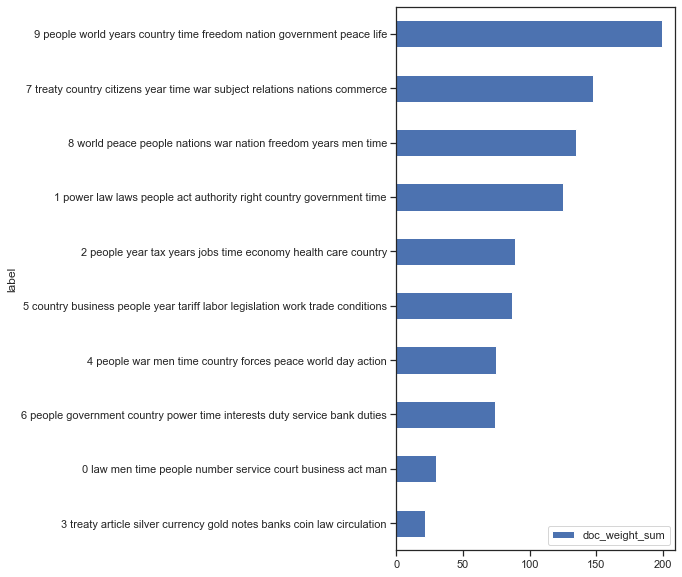

In [158]:
TOPICS.sort_values('doc_weight_sum', ascending=True).plot.barh(y='doc_weight_sum', x='label', figsize=(5,10)) 

## Explore Topics by President

In [159]:
topic_cols = [t for t in range(n_topics)]
PRESIDENTS = THETA.groupby('pres_id')[topic_cols].mean().T                                            
PRESIDENTS.index.name = 'topic_id'

In [161]:
PRESIDENTS['topterms'] = TOPICS[[i for i in range(10)]].apply(lambda x: ' '.join(x), 1)
president_dict = group_df.reset_index().set_index('pres_id')['President'].to_dict() # to rename the columns in terms of president names
PRESIDENTS = PRESIDENTS.rename(columns = president_dict)

In [162]:
PRESIDENTS[['Barack Obama','Donald Trump','topterms']].sort_values('Barack Obama', ascending=False).style.background_gradient()

pres_id,Barack Obama,Donald Trump,topterms
topic_id,,,
9,0.516864,0.678677,people world years country time freedom nation government peace life
2,0.439541,0.276557,people year tax years jobs time economy health care country
8,0.0159729,0.00926052,world peace people nations war nation freedom years men time
4,0.0114943,0.0178099,people war men time country forces peace world day action
1,0.00785057,0.000273983,power law laws people act authority right country government time
0,0.00444043,0.00996549,law men time people number service court business act man
5,0.00200915,0.003623,country business people year tariff labor legislation work trade conditions
7,0.00146463,0.00135957,treaty country citizens year time war subject relations nations commerce
6,0.00018161,0.00199611,people government country power time interests duty service bank duties


In [241]:
PRESIDENTS[['Barack Obama','Donald Trump','Theodore Roosevelt', 'George Washington','topterms']].sort_values('Donald Trump', ascending=False).style.background_gradient()

pres_id,Barack Obama,Donald Trump,Theodore Roosevelt,George Washington,topterms
topic_id,,,,,
9,0.516864,0.678677,0.0810348,0.00643015,people world years country time freedom nation government peace life
2,0.439541,0.276557,0.00519675,0.00115506,people year tax years jobs time economy health care country
4,0.0114943,0.0178099,0.0889233,0.0115458,people war men time country forces peace world day action
0,0.00444043,0.00996549,0.16754,0.0697442,law men time people number service court business act man
8,0.0159729,0.00926052,0.0324452,0.00323097,world peace people nations war nation freedom years men time
5,0.00200915,0.003623,0.271451,0.00115509,country business people year tariff labor legislation work trade conditions
6,0.00018161,0.00199611,0.0270043,0.195704,people government country power time interests duty service bank duties
7,0.00146463,0.00135957,0.101259,0.324678,treaty country citizens year time war subject relations nations commerce
3,0.000181601,0.000477437,0.065198,0.00897499,treaty article silver currency gold notes banks coin law circulation


In [165]:
PRESIDENTS.sort_index(ascending=False).style.background_gradient()

pres_id,George Washington,John Adams,Thomas Jefferson,James Madison,James Monroe,John Quincy Adams,Andrew Jackson,Martin Van Buren,William Harrison,John Tyler,James K. Polk,Zachary Taylor,Millard Fillmore,Franklin Pierce,James Buchanan,Abraham Lincoln,Andrew Johnson,Ulysses S. Grant,Rutherford B. Hayes,James A. Garfield,Chester A. Arthur,Grover Cleveland 1,Benjamin Harrison,Grover Cleveland 2,William McKinley,Theodore Roosevelt,William Taft,Woodrow Wilson,Warren G. Harding,Calvin Coolidge,Herbert Hoover,Franklin D. Roosevelt,Harry S. Truman,Dwight D. Eisenhower,John F. Kennedy,Lyndon B. Johnson,Richard M. Nixon,Gerald Ford,Jimmy Carter,Ronald Reagan,George H. W. Bush,Bill Clinton,George W. Bush,Barack Obama,Donald Trump,topterms
topic_id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
9,0.00643015,0.0477141,0.0797941,0.0241913,0.000388147,0.0458093,0.00198175,0.00215919,0.000101555,0.00606242,0.00503513,0.00036787,0.00254675,0.000546848,0.00627053,0.132266,0.00774678,0.0126923,0.000658548,0.0695507,0.0265381,0.00180799,0.0340569,0.00105726,0.0143061,0.0810348,0.000239869,0.0508924,0.272371,0.13183,0.0637124,0.142971,0.357274,0.169238,0.278281,0.236126,0.21296,0.205763,0.190009,0.500229,0.521805,0.541358,0.638703,0.516864,0.678677,people world years country time freedom nation government peace life
8,0.00323097,0.0120398,0.00050188,0.00847851,0.000946706,0.0334195,0.000445822,0.000416487,0.00010155,0.00823707,0.00400769,0.000367895,0.000348821,0.0159223,0.00958369,0.0126632,0.000922296,0.00698517,0.00705244,0.0919464,0.018109,0.011304,0.0059141,0.0249985,0.0724897,0.0324452,0.0211703,0.353796,0.30511,0.0881498,0.0817624,0.266125,0.298492,0.761829,0.520105,0.322376,0.364552,0.388614,0.415406,0.223654,0.212789,0.0411248,0.0328234,0.0159729,0.00926052,world peace people nations war nation freedom years men time
7,0.324678,0.442903,0.491013,0.525024,0.815036,0.531584,0.400996,0.400949,0.000101549,0.468382,0.575314,0.408388,0.559536,0.456702,0.225398,0.220514,0.0520801,0.251361,0.149939,0.000163707,0.468004,0.234187,0.333549,0.221663,0.340813,0.101259,0.155277,0.0635746,0.00247865,0.0437312,0.00267006,0.00657726,0.00576863,0.0048966,0.00103081,0.00778461,0.000339754,0.000302815,0.00468092,0.00267837,0.000259131,0.000309162,0.000876941,0.00146463,0.00135957,treaty country citizens year time war subject relations nations commerce
6,0.195704,0.251111,0.15457,0.177089,0.135304,0.265399,0.304736,0.385655,0.304042,0.287391,0.104685,0.301903,0.05694,0.085834,0.1017,0.0128182,0.0552241,0.134727,0.162368,0.43965,0.0823699,0.276468,0.0390009,0.124811,0.144084,0.0270043,0.0243817,0.104597,0.190926,0.173722,0.0215278,0.0164911,0.0124504,0.01335,0.00427278,0.00187715,0.00549401,0.0187879,0.00466321,0.00662532,0.00218441,0.000309162,0.00500467,0.00018161,0.00199611,people government country power time interests duty service bank duties
5,0.00115509,0.000556321,0.00377252,0.000597508,0.000121315,0.00632303,0.000445826,0.000764078,0.000101547,0.0465907,0.00281185,0.000367868,0.0189213,0.00773972,0.00477578,0.0150968,0.0237166,0.075213,0.0547827,0.0325059,0.140262,0.145699,0.230056,0.186896,0.232279,0.271451,0.576223,0.15832,0.163189,0.414595,0.701068,0.211868,0.115165,0.0201693,0.0328171,0.0284958,0.00632692,0.0301504,0.0284837,0.0089021,0.00795249,0.00290448,0.0150088,0.00200915,0.003623,country business people year tariff labor legislation work trade conditions
4,0.0115458,0.0515318,0.0101922,0.0402207,0.00333315,0.000321935,0.00463451,0.0207748,0.000101548,0.00743664,0.025972,0.00036788,0.00152304,0.00647018,0.046417,0.150178,0.0309481,0.0121663,0.0208653,0.000163708,0.00050866,0.0175289,0.131405,0.00223974,0.0388621,0.0889233,0.00392658,0.0878016,0.0502075,0.0426823,0.017469,0.244546,0.136932,0.00972963,0.0638043,0.302731,0.280205,0.0316034,0.0609373,0.063797,0.0649159,0.0474785,0.0464644,0.0114943,0.0178099,people war men time country forces peace world day action
3,0.00897499,0.000556333,0.000501863,0.000597543,0.00933768,0.00288767,0.0119811,0

According to the LDA Model, Trump and Obama talk mostly about the same two topics. The top terms of the first topic suggest some typical president talk; government, jobs, economy, world. These are broad things presidents like to talk about. The second has terms of world affairs like; world, peace, war, nations, men, freedom. Adding in George Washington, we see a different set of topics prevelent. Washington talked about topics including; country, power, citizens, treaty, subject, government etc. These words seem slightly similar to the second topic (topic_id 1) but phrased in different words and different contexts. Obama and Trump spoke in large ideals of peace, war freedom, nations. Washington speaks in seemingly lower/simpler concepts of citizenship, treaties, subjects, authority, etc. Looking at the whole picture, you can see that the topics change through time. Specifically, by the FDR administration the topics change completely to topic_id one throughout all following presidents. There could be a couple reasons for this, the great influence of Roosevelt on American governance, as well as the changing role the president (and the country) has after WW2, since topic_id one has mostly to do with world affairs of war and peace.

# Word2Vec

## Configuration

In [166]:
window = 5
BAG = SPEECH # speeches bag

In [167]:
corpus = TOKEN[~TOKEN.pos.str.match('NNPS?')]\
    .groupby(BAG)\
    .term_str.apply(lambda  x:  x.tolist())\
    .reset_index()['term_str'].tolist()

## Generate word embeddings with Gensim's library

In [168]:
model = word2vec.Word2Vec(corpus, size=246, window=window, min_count=200, workers=4)

## Visualize with tSNE

In [169]:
coords = pd.DataFrame(index=range(len(model.wv.vocab)))
coords['label'] = [w for w in model.wv.vocab]
coords['vector'] = coords['label'].apply(lambda x: model.wv.get_vector(x))

### Use ScikitLearn's TSNE library

In [171]:
tsne_model = TSNE(perplexity=40, n_components=2, init='pca', n_iter=2500, random_state=23)
tsne_values = tsne_model.fit_transform(coords['vector'].tolist())

In [172]:
coords['x'] = tsne_values[:,0]
coords['y'] = tsne_values[:,1]

### Plot the coordinates

In [174]:
px.scatter(coords, 'x', 'y', text='label', height=1000).update_traces(mode='text')

Here we can see certain terms bunch up together. For instance, in the lower area (around (-10,-30)) we can see terms dealing with finance and economics (deficit, balance, fiscal).

# Semantic Algebra

In [175]:
def complete_analogy(A, B, C, n=2):
    try:
        return model.wv.most_similar(positive=[B, C], negative=[A])[0:n]
    except KeyError as e:
        print('Error:', e)
        return None

In [176]:
complete_analogy('democracy', 'prosperity', 'soviet')

[('strategic', 0.6413828134536743), ('western', 0.602614164352417)]

In [177]:
complete_analogy('criminal', 'violence', 'judge')

[('succeed', 0.6285148859024048), ('fail', 0.5806616544723511)]

The analogies don't make a ton of sense here. Perhaps criminal:violence is judge:fight means judges fight criminals? Not sure

In [178]:
model.wv.most_similar('democracy')

[('freedom', 0.7733227014541626),
 ('civilization', 0.7465357184410095),
 ('liberty', 0.7194623947143555),
 ('society', 0.6861046552658081),
 ('strong', 0.6780810356140137),
 ('mankind', 0.6599998474121094),
 ('united', 0.6468304395675659),
 ('spirit', 0.6465371251106262),
 ('independence', 0.6400517225265503),
 ('strength', 0.6292545795440674)]

In [179]:
model.wv.most_similar('terrorists')

[('terror', 0.758604884147644),
 ('violence', 0.700558066368103),
 ('enemies', 0.6763392090797424),
 ('aggression', 0.6708017587661743),
 ('fight', 0.6443959474563599),
 ('armed', 0.6318793296813965),
 ('forces', 0.6244771480560303),
 ('hostile', 0.6199169754981995),
 ('air', 0.5734862089157104),
 ('ships', 0.5668820142745972)]

Both of these similarity models produce good results. 'Terrorists' certainly are related to 'violence', 'terror', 'enemies' etc. and 'democracy' is related to 'freedom', 'civilization', 'liberty', etc.

In [180]:
model.wv.most_similar(['soviet'],['hostile'])

[('signed', 0.38507378101348877),
 ('negotiations', 0.37313780188560486),
 ('reached', 0.36571699380874634),
 ('entirely', 0.3642287254333496),
 ('changes', 0.36110880970954895),
 ('concluded', 0.3540785014629364),
 ('agreements', 0.34601670503616333),
 ('beginning', 0.34193238615989685),
 ('last', 0.3394584059715271),
 ('issues', 0.3360194265842438)]

This suggests that there was a lot of emphasis on negotions and discussions with the 'hostile' 'soviets' in these speeches. We see 'cooperation' and 'agreements', as well  as 'historic'.

In [181]:
model.wv.most_similar(['terrorists'],['war'])

[('local', 0.5352042317390442),
 ('agents', 0.5025299787521362),
 ('police', 0.45691797137260437),
 ('communities', 0.4507041871547699),
 ('groups', 0.4218503534793854),
 ('individuals', 0.4066140055656433),
 ('respective', 0.40099626779556274),
 ('ones', 0.39331281185150146),
 ('themselves', 0.38843590021133423),
 ('enforce', 0.38124579191207886)]

Here we some form of discussion on our dealings with 'terrorists' and 'war'. We see 'agents', 'local', 'individual', 'groups', etc. This may be presidents talking about how they see these groups (ie as 'local', 'individual', or 'groups') or how they aim to deal with the war on terror (ie use 'local' help to 'police' or 'enforce').

# Sentiment Analysis of Novels 

In [182]:
OHCO = ['pres_id', 'speech_id','sent_num', 'token_num'] 
SPEECH = OHCO[1:2]
SENTS = OHCO[1:3]
salex_csv = 'salex_nrc.csv'
nrc_cols = "nrc_negative nrc_positive nrc_anger nrc_anticipation nrc_disgust nrc_fear nrc_joy nrc_sadness nrc_surprise nrc_trust".split()
emo = 'polarity'
trump = 45 #'Donald Trump'
obama = 44 #'Barack Obama'

## Get Lexicon

In [183]:
salex = pd.read_csv(salex_csv).set_index('term_str')
salex.columns = [col.replace('nrc_','') for col in salex.columns]

In [184]:
salex['polarity'] = salex.positive - salex.negative

## Get lexicon columns

In [185]:
emo_cols = "anger anticipation disgust fear joy sadness surprise trust polarity".split()

### Get Novels

In [186]:
TOKEN = TOKEN.reset_index().set_index(PRES).sort_index()

In [187]:
TOKEN = TOKEN.join(salex, on='term_str', how='left')
TOKEN[emo_cols] = TOKEN[emo_cols].fillna(0)

In [188]:
TOKEN[salex.columns].sample(10)

,anger,anticipation,disgust,fear,joy,negative,positive,sadness,surprise,trust,polarity
pres_id,,,,,,,,,,,
44,0.0,0.0,0.0,0.0,0.0,NaN,NaN,0.0,0.0,0.0,0.0
28,0.0,0.0,0.0,0.0,0.0,NaN,NaN,0.0,0.0,0.0,0.0
44,0.0,0.0,0.0,0.0,0.0,NaN,NaN,0.0,0.0,0.0,0.0
36,0.0,0.0,0.0,0.0,0.0,NaN,NaN,0.0,0.0,0.0,0.0
29,0.0,0.0,0.0,0.0,0.0,NaN,NaN,0.0,0.0,0.0,0.0
28,0.0,0.0,0.0,0.0,0.0,NaN,NaN,0.0,0.0,0.0,0.0
36,0.0,0.0,0.0,0.0,0.0,NaN,NaN,0.0,0.0,0.0,0.0
17,0.0,0.0,0.0,0.0,0.0,NaN,NaN,0.0,0.0,0.0,0.0
35,0.0,0.0,0.0,0.0,0.0,NaN,NaN,0.0,0.0,0.0,0.0


In [189]:
TOKEN[['term_str'] + emo_cols].sample(10)

,term_str,anger,anticipation,disgust,fear,joy,sadness,surprise,trust,polarity
pres_id,,,,,,,,,,
32,agreed,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0
4,protect,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
31,consideration,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
40,past,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
40,between,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
10,the,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
44,is,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
25,chairman,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0
37,at,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [190]:
TOKEN[emo_cols] = TOKEN[emo_cols].fillna(0)

In [191]:
TOKEN.head()

,speech_id,sent_num,token_num,pos_tuple,pos,token_str,term_str,term_id,anger,anticipation,disgust,fear,joy,negative,positive,sadness,surprise,trust,polarity
pres_id,,,,,,,,,,,,,,,,,,,
1,981,24,111,"(depend., VB)",VB,depend.,depend,11604,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
1,964,7,27,"(of, IN)",IN,of,of,24996,0.0,0.0,0.0,0.0,0.0,NaN,NaN,0.0,0.0,0.0,0.0
1,964,7,28,"(an, DT)",DT,an,an,4601,0.0,0.0,0.0,0.0,0.0,NaN,NaN,0.0,0.0,0.0,0.0
1,964,7,29,"(impeachment,, NN)",NN,"impeachment,",impeachment,18827,0.0,0.0,0.0,0.0,0.0,NaN,NaN,0.0,0.0,0.0,0.0
1,964,7,30,"(which, WDT)",WDT,which,which,38460,0.0,0.0,0.0,0.0,0.0,NaN,NaN,0.0,0.0,0.0,0.0


In [192]:
TRUMP = TOKEN.loc[trump].copy()
OBAMA = TOKEN.loc[obama].copy()

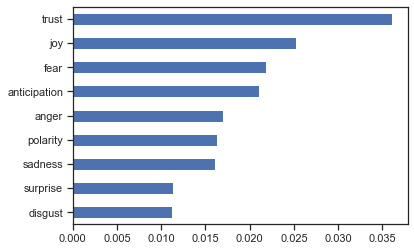

In [193]:
TRUMP[emo_cols].mean().sort_values().plot.barh()

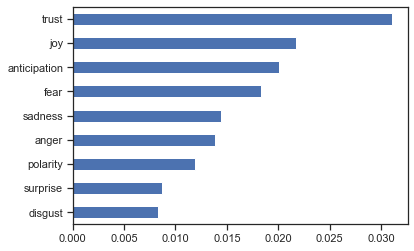

In [194]:
OBAMA[emo_cols].mean().sort_values().plot.barh()

Both Trump and Obama have 'trust' and 'joy' as their top sentiments. Below that is where they differ. Trump is higher on 'fear', which is third, versus Obama, in which 'anticipation' is third ('fear' is fourth for Obama). Trump is also higher on 'anger' and 'sadness'.

# Sentiment by Speech

In [195]:
TRUMP_speech = TRUMP.groupby(SPEECH)[emo_cols].mean()

In [196]:
OBAMA_speech = OBAMA.groupby(SPEECH)[emo_cols].mean()

In [197]:
def plot_sentiments(df, emo='polarity'):
    FIG = dict(figsize=(25, 5), legend=True, fontsize=14, rot=45)
    df[emo].plot(**FIG)

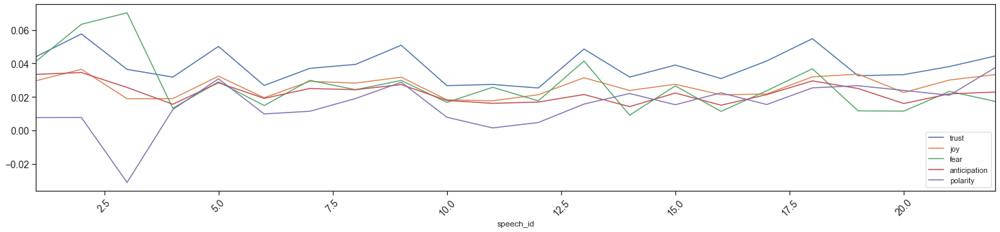

In [198]:
plot_sentiments(TRUMP_speech, ['trust','joy','fear','anticipation','polarity'])

Most speeches for Trump have positive polarity, however there is a speech recently that is very negative and high on fear. It looks as though it is probably speech_id 3, where President Trump announces the death of Abu Bakr al-Baghdadi, the founder and leader of ISIS. This speech would have a lot of negative words, which would explain the negative polarity here.

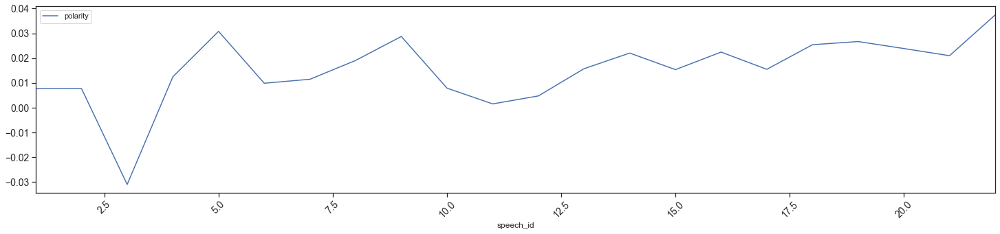

In [199]:
plot_sentiments(TRUMP_speech, ['polarity'])

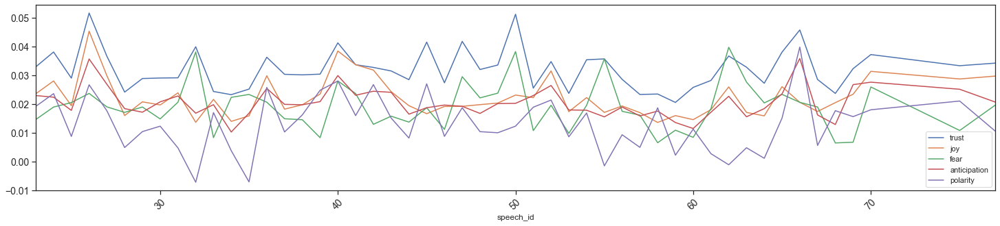

In [200]:
plot_sentiments(OBAMA_speech, ['trust','joy','fear','anticipation','polarity'])

Obama's speeches are much more over the place in terms of polarity and emotion. There is a lot of spikes in his sentiment plot. You can see where the polarity spikes downward, the fear spikes up. Obama's final speech largely ends up where his first speech is. 

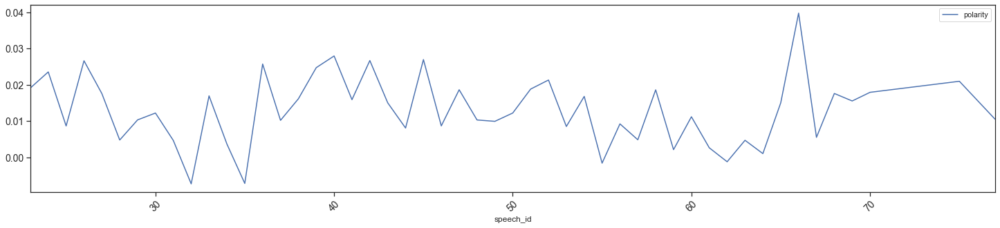

In [201]:
plot_sentiments(OBAMA_speech, ['polarity'])

# Explore Sentiment in Texts

In [202]:
TRUMP['html'] =  TRUMP.apply(lambda x: "<span class='sent{}'>{}</span>".format(int(np.sign(x[emo])), x.token_str), 1)
OBAMA['html'] =  OBAMA.apply(lambda x: "<span class='sent{}'>{}</span>".format(int(np.sign(x[emo])), x.token_str), 1)

In [203]:
TRUMP_sents = TRUMP.groupby(SENTS)[emo_cols].mean()
OBAMA_sents = OBAMA.groupby(SENTS)[emo_cols].mean()

In [205]:
TRUMP_sents['sent_str'] = TRUMP.groupby(SENTS).term_str.apply(lambda x: x.str.cat(sep=' '))
TRUMP_sents['html_str'] = TRUMP.groupby(SENTS).html.apply(lambda x: x.str.cat(sep=' '))

In [206]:
OBAMA_sents['sent_str'] = OBAMA.groupby(SENTS).term_str.apply(lambda x: x.str.cat(sep=' '))
OBAMA_sents['html_str'] = OBAMA.groupby(SENTS).html.apply(lambda x: x.str.cat(sep=' '))

In [207]:
def sample_sentences(df):
    rows = []
    for idx in df.sample(10).index:

        valence = round(df.loc[idx, emo], 4)     
        t = 0
        if valence > t: color = '#ccffcc'
        elif valence < t: color = '#ffcccc'
        else: color = '#f2f2f2'
        z=0
        rows.append("""<tr style="background-color:{0};padding:.5rem 1rem;font-size:110%;">
        <td>{1}</td><td>{3}</td><td width="400" style="text-align:left;">{2}</td>
        </tr>""".format(color, valence, df.loc[idx, 'html_str'], idx))

    display(HTML('<style>#sample1 td{font-size:120%;vertical-align:top;} .sent-1{color:red;font-weight:bold;} .sent1{color:green;font-weight:bold;}</style>'))
    display(HTML('<table id="sample1"><tr><th>Sentiment</th><th>ID</th><th width="600">Sentence</th></tr>'+''.join(rows)+'</table>'))

In [208]:
sample_sentences(TRUMP_sents)

Sentiment,ID,Sentence
0.0769,"(11, 354)",make it possible for that patient to get that drug. to going We’re
0.0455,"(17, 12)",our deepest sympathies and most heartfelt prayers for the victims of the train derailment in expressing Washington by me Let begin State.
-0.0426,"(21, 1)","that stands united in condemning hate and evil in all its forms. country a we shooting in Kansas City, remind us that while we may be aNation divided on policies, weeks last well Recent threats targeting Jewish Community Centers and vandalism of Jewish cemeteries, as as are"
0.1429,"(14, 320)","”You know, they talk a good game."
0.0,"(11, 177)",They don’t want it to be approved.
0.0455,"(5, 52)","To advance Chinese the $8. up government’s five-year economic plan, a company owned by the Chinese stateallegedlystole Micron’s designs, valued at to"
0.0,"(12, 442)",We better take care of our military.
-0.1333,"(15, 140)",Six of members the savage gang MS-13 have been charged with Kayla and Nisa’s murders.
0.0244,"(9, 140)","accordance in policy with own its its national immigration set room this in every of right the recognize We interests, to nation the as doing. we ask other countries to respect just our right to do same which we are own"
0.0,"(12, 538)",You’ve probably seen her picture.


In [209]:
sample_sentences(OBAMA_sents)

Sentiment,ID,Sentence
0.0667,"(62, 170)",about. spoke Kennedy President that evolution the about bringing in ingredients vital are All these
0.0,"(67, 216)",my of end the by half in deficit first the to pledged I where summit fiscal a held cut term in office. I yesterday And
0.0317,"(53, 146)","growth. job encouraging be will fact, in but, recovery our undermining be won’t that smart, are that intelligent, are that make can we recovery the sustain help will that now right do can we that things some are there So and advance even cuts budget of kinds what years several next the over okay, out, figuring and down sitting also we’re as it,"
0.037,"(46, 86)","anyone hire they if credit tax $4,000 a get will companies and bill, jobs this Pass who has more spent job. a for looking months six than"
0.0385,"(43, 70)","bringing are who leaders business with worked I’ve jobs back America products. better make we because but pay, less make workers our because not , to"
0.0606,"(40, 60)","freedom. for long who those of behalf on act to us compel conscience our and interests our because East, the Middle to Americas the from Africa, to Asia from democracy support will We"
0.0,"(36, 103)",volatile region. a in race arms an spark would It
0.0392,"(40, 28)","knows poverty bleakest the into born girl little a when creed our to true are We that she the has equal, is she and free, is she American; an is she because else, anybody as succeed to chance same not just the own. our in also but God of eyes in"
0.0,"(43, 207)",that. did You
0.1,"(57, 72)","debate. that encourage I and debate, legitimate a that’s And"


Along with the general problem of how these words are classified, some of these sentences don't look correct. This is something that needs to be improved upon. It may be a problem with the tokenizer and the dataset in particular.